# Demonstration of Hard Negative Mining

In [19]:
%load_ext autoreload
%autoreload 2  

import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display
from collections import defaultdict

import sys
sys.path.append("..")

from modules.utils.loss import Loss
from modules.inference.model import Detector
from modules.inference.nms import NMS
from modules.rectification.hard_negative_mining import HardNegativeMiner

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### Initialize the required components and default parameters
You will need to initialize Detector, NMS, and Loss objects.

In [20]:
## Initialize Model
WEIGHTS_PATH = "../storage/yolo_models/yolov4-tiny-logistics_size_416_1.weights"
CONFIG_PATH = "../storage/yolo_models/yolov4-tiny-logistics_size_416_1.cfg"
CLASS_NAMES_PATH = "../storage/yolo_models/logistics.names"
SCORE_THRESHOLD = 0.2

print("[INFO] Loading YOLO Model...")
detector = Detector(WEIGHTS_PATH, CONFIG_PATH, CLASS_NAMES_PATH, SCORE_THRESHOLD)
print("[INFO] Model loaded successfully.")

## Initialize NMS
IOU_THRESHOLD = 0.5
print("[INFO] Initializing Non-Maximum Suppression...")
nms = NMS(SCORE_THRESHOLD, IOU_THRESHOLD)
print("[INFO] NMS initialized.")

## Initialize Loss
NUM_CLASSES = 20
LAMBDA_COORD = 0.5
LAMBDA_NOOBJ = 0.5
print("[INFO] Initializing (modified) YOLO Loss...")
measure = Loss(num_classes=NUM_CLASSES, 
                iou_threshold=IOU_THRESHOLD, 
                lambda_coord=LAMBDA_COORD, 
                lambda_noobj=LAMBDA_NOOBJ)
print("[INFO] Loss initialized.")

[INFO] Loading YOLO Model...
[INFO] Model loaded successfully.
[INFO] Initializing Non-Maximum Suppression...
[INFO] NMS initialized.
[INFO] Initializing (modified) YOLO Loss...
[INFO] Loss initialized.


### Initialize HardNegativeMiner

In [21]:
# Specify dataset directory
dataset_directory = "../storage/logistics" # HINT: When developing, you might want to test on a smaller sample dataset! However, you must run through the entire dataset for your analysis.

# Initialize the HardNegativeMiner
print("[INFO] Initializing HardNegativeMiner...")
hard_negative_miner = HardNegativeMiner(detector, measure, dataset_directory)
print("[INFO] HardNegativeMiner initialized.")

[INFO] Initializing HardNegativeMiner...
[INFO] HardNegativeMiner initialized.


In [22]:
#  A helper function to draw boxes for given image
def draw_boxes(image, bboxes, class_ids, confidence_scores):
    h_img, w_img = image.shape[:2]  # Get image height and width

    for i, (x_center, y_center, w, h) in enumerate(bboxes):
        # Rescale coordinates from 0-1 to pixel values
        x_center, y_center, w, h = (
            x_center * w_img, 
            y_center * h_img, 
            w * w_img, 
            h * h_img
        )
        
        # Convert center-based coordinates to top-left-based
        x1 = int(x_center - w / 2)
        y1 = int(y_center - h / 2)
        x2 = int(x_center + w / 2)
        y2 = int(y_center + h / 2)

        # Draw bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Prepare label text
        label = f"Class {class_ids[i]}: {confidence_scores[i]:.2f}"

        # Put label text on the frame
        cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 0, 255), 2)
        
    return image

# helper function to display images
def display_images(images_dict, figsize):
    n_rows=10
    n_cols = len(images_dict)
    fig, axes = plt.subplots(n_rows, n_cols, figsize=figsize)

    for i in range(n_rows):
        j = 0
        for img_title, img_list in images_dict.items():
            # Display the image
            axes[i, j].imshow(cv2.cvtColor(img_list[i], cv2.COLOR_BGR2RGB))
            axes[i, j].axis("off")
            axes[i, j].set_title(f"{img_title}: image_{i+1}")
            j += 1
            
    plt.tight_layout()
    plt.show()

# A helper function to display images with bounding boxes from annotations
def display_annotated_images(perf_table_dict, figsize=(10, 30)): # perf_table_dict format: {'title_1': perf_table_1}
    annotated_images_dict = defaultdict(list)

    for title, perf_table in perf_table_dict.items():
        for i, img_file in enumerate(perf_table['image_file']):
            img = cv2.imread(img_file)

            # Draw annotated objects  
            anno_bboxes, anno_class_ids = perf_table['annotation'].iloc[i]
            anno_scores = [1.0] * len(anno_bboxes)
            anno_img = draw_boxes(np.copy(img), anno_bboxes, anno_class_ids, anno_scores)
            annotated_images_dict[title].append(anno_img)

    display_images(annotated_images_dict, figsize)

#

---

#### **Task 4: Assignment Instructions:**

Complete the following tasks using the logistic dataset. Assume that this dataset represents real-world production data. To ensure accurate and reliable analysis, apply objective methods and quantitative measurements to evaluate the behavior of each system component.

- **Baseline Analysis**: *Establish initial performance benchmarks.*
- **Task A**: *Analyze impact of Loss parameters.*
- **Task B**: *Analyze impact of Detector and NMS parameters.*
- **Task C**: *Analyze impact of HardNegativeMiner parameters.*

**Reminder:**  
- Your notebook should be well-structured and clear for effective presentation. Up to 10 points may be deducted for poor structure and clarity.
- Consider this report as if it were being reviewed by **TechTrack stakeholders**. Keep it professional, insightful, and visually organized!
- Use visualizations, tables, and quantitative analysis where applicable to support your findings.

#

---

### **Baseline Analysis**
**1. Displaying hard negatives using the default parameters**
- Display the **top 10** and **bottom 10** hard negatives using the default parameters (as provided above).

**2. Observations & Analysis**
- Describe the types of images are prioritized as hard negatives.


In [23]:
# Retrieve top 10 and bottom 10 hard negatives (based on total_loss)
top_10_hard_negatives_baseline, bottom_10_hard_negatives_baseline = hard_negative_miner.sample_hard_negatives(num_hard_negatives=10, criteria="total_loss")
print("[INFO] Retrieved the top 10 and bottom 10 hard negatives")


[INFO] Retrieved the top 10 and bottom 10 hard negatives


In [24]:
print("Top 10 hard negatives using default parameters:")
display(top_10_hard_negatives_baseline)

print("Bottom 10 hard negatives using default parameters:")
display(bottom_10_hard_negatives_baseline)

Top 10 hard negatives using default parameters:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
1339,../storage/logistics/1579164086-6736007_jpg.rf...,../storage/logistics/1579164086-6736007_jpg.rf...,"([[0.84296875, 0.09140625, 0.3015625, 0.170312...",0.287468,12027.413236,155.205386,12182.906090
1336,../storage/logistics/1579163982-3432484_jpg.rf...,../storage/logistics/1579163982-3432484_jpg.rf...,"([[0.7484375, 0.371875, 0.209375, 0.140625], [...",0.381739,4547.357523,143.635904,4691.375166
1238,../storage/logistics/1574676188-741767_jpg.rf....,../storage/logistics/1574676188-741767_jpg.rf....,"([[0.80859375, 0.7734375, 0.0921875, 0.046875]...",0.136964,3517.929426,103.575710,3621.642099
1229,../storage/logistics/1574675826-0214434_jpg.rf...,../storage/logistics/1574675826-0214434_jpg.rf...,"([[0.51171875, 0.6234375, 0.0640625, 0.028125]...",0.027298,3370.668201,93.120342,3463.815840
7058,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,"([[0.9390625, 0.4984375, 0.121875, 0.14375], [...",0.438185,2173.951904,210.317137,2384.707226
2788,../storage/logistics/961899-5841_jpg.rf.99d927...,../storage/logistics/961899-5841_jpg.rf.99d927...,"([[0.96171875, 0.57890625, 0.0734375, 0.048437...",0.055023,2205.751662,53.167561,2258.974246
7050,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,"([[0.23671875, 0.00859375, 0.0609375, 0.017187...",0.681417,1944.232257,228.682299,2173.595974
1335,../storage/logistics/1579163928-9913452_jpg.rf...,../storage/logistics/1579163928-9913452_jpg.rf...,"([[0.79765625, 0.659375, 0.3578125, 0.146875],...",0.063887,2010.757037,63.934027,2074.754950
1327,../storage/logistics/1579163630-345785_jpg.rf....,../storage/logistics/1579163630-345785_jpg.rf....,"([[0.27734375, 0.6984375, 0.2046875, 0.13125],...",0.206793,1927.080565,136.385192,2063.672550
2492,../storage/logistics/510380776-956_jpg.rf.c85d...,../storage/logistics/510380776-956_jpg.rf.c85d...,"([[0.30703125, 0.83359375, 0.3765625, 0.254687...",0.195640,1916.451134,21.528248,1938.175023


Bottom 10 hard negatives using default parameters:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
3227,../storage/logistics/FWrexZvPmEf6gE3iEB2jacolg...,../storage/logistics/FWrexZvPmEf6gE3iEB2jacolg...,"([[0.47734375, 0.53203125, 0.9328125, 0.935937...",0.0,0.043012,0.0,0.043012
5236,../storage/logistics/fd5YCV2MuZEEKcZQS_mJlcntm...,../storage/logistics/fd5YCV2MuZEEKcZQS_mJlcntm...,"([[0.5765625, 0.49765625, 0.696875, 0.9203125]...",0.0,0.039434,0.0,0.039434
6900,../storage/logistics/monitorimage002_jpg.rf.3d...,../storage/logistics/monitorimage002_jpg.rf.3d...,"([[0.5125, 0.59609375, 0.828125, 0.7015625]], ...",0.0,0.023087,0.0,0.023087
3049,../storage/logistics/EAN13_09_0046_jpg.rf.ef5b...,../storage/logistics/EAN13_09_0046_jpg.rf.ef5b...,"([[0.53046875, 0.49921875, 0.9140625, 0.995312...",0.0,0.020399,0.0,0.020399
2210,../storage/logistics/4002039216304-01_N95-2592...,../storage/logistics/4002039216304-01_N95-2592...,"([[0.52890625, 0.49609375, 0.1765625, 0.473437...",0.0,0.020346,0.0,0.020346
5985,../storage/logistics/fire6_mp4-1184_jpg.rf.49a...,../storage/logistics/fire6_mp4-1184_jpg.rf.49a...,"([[0.7234375, 0.93125, 0.121875, 0.125]], [3])",0.0,0.015014,0.0,0.015014
3821,../storage/logistics/IMG_20230526_104135_074_j...,../storage/logistics/IMG_20230526_104135_074_j...,"([[0.53046875, 0.46953125, 0.9390625, 0.785937...",0.0,0.013299,0.0,0.013299
8750,../storage/logistics/traffic-light-654-_jpg.rf...,../storage/logistics/traffic-light-654-_jpg.rf...,"([[0.52265625, 0.8609375, 0.0578125, 0.025]], ...",0.0,0.007130,0.0,0.007130
5868,../storage/logistics/fire23_mp4-762_jpg.rf.507...,../storage/logistics/fire23_mp4-762_jpg.rf.507...,"([[0.4734375, 0.475, 0.0875, 0.046875]], [14])",0.0,0.002994,0.0,0.002994
5869,../storage/logistics/fire23_mp4-764_jpg.rf.8ec...,../storage/logistics/fire23_mp4-764_jpg.rf.8ec...,"([[0.4703125, 0.47109375, 0.0875, 0.0484375]],...",0.0,0.002501,0.0,0.002501


#### Observations
1. Different magnitudes of sub-loss components 
    
    From the performance table above, the scale of the 3 sub-loss components (Localization, Objectness, and Classification) varies from each other, due to different computation methods.
    - Localization loss: is computed based on Bounding Box Regression, to measure the difference between detected bounding box and the ground truth.
    - Objectness loss: is based on the MSE between predicted confidence score and the ground truth (1 for annotated objects and 0 for non-annotated ones). 
    - Classification loss: uses Cross-Entropy Loss, and its scale depends on the number of classes.
    
    Since these loss terms have different magnitudes, one can dominate, leading to imbalanced learning. 
    
    In this case, the objectness loss is in the dominant place, the model may ignore or underweight the others. The weight factors (e.g. lambda_coord, lambda_obj, lambda_noobj, lambda_cls) can be further calibrated for a balanced result. 



2. Great performance for the bottom 10 hard negatives
    
    Particularly, the major loss component is the objectness loss for the bottom 10 hard negatives, while the other two are zeroes. Sinc the confidence score from prediction is a score between 0 and 1, confidence loss cannot be exactly 0 in most cases. As the total loss is near-zero, it indicates a great performance for object localization and class prediction.

Baseline - Display annotated images for top 10 and bottom 10 hard negatives


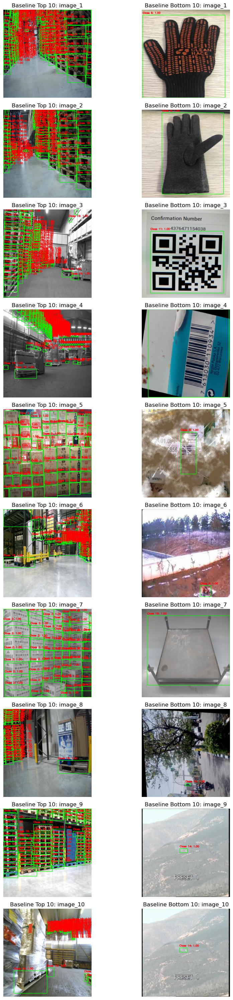

In [25]:
print("Baseline - Display annotated images for top 10 and bottom 10 hard negatives")
display_annotated_images(
    {'Baseline Top 10':top_10_hard_negatives_baseline, 
     'Baseline Bottom 10': bottom_10_hard_negatives_baseline,
    },
)

#### Observations
The figure above demonstrated top 10 and bottom 10 hard negatives with baseline settings. There are two main factors affecting the total_loss for top negatives.
1. No. of objects to be detected

    As illustrated above, the top 10 images are very condensed with objects,  while the bottom 10 ones are quite simple with 1 object per image, making it's easier for model to identify. 

2. Background noise

    The top hard negatives come with more chaotic background, while the bottome ones are relatively clean. The simple background can provide better contrast to the object and reduce the noise in detection. 

---

### **Task A**

**1. Displaying hard negatives while varying loss parameters**  

- Display the **top 10** and **bottom 10** hard negatives with:  
  - **λ_coord** = **1.0**  
  - **λ_noobj** = **0.0**  

- Display the **top 10** and **bottom 10** hard negatives with:  
  - **λ_coord** = **0.0**  
  - **λ_noobj** = **1.0**  

**2. Observations & Analysis**  

- How do different loss parameter settings (**λ_coord**, **λ_noobj**) impact the selection of hard negatives?  
- What types of samples are prioritized under each criterion?  
- Under what conditions would each parameter set be **most useful** for improving the model’s performance? 

In [26]:
# Task A part_1: Display the **top 10** and **bottom 10** hard negatives with:  
#   λ_coord = 1.0
#   λ_noobj = 0.0

# Initialize Loss
print("[INFO] Initializing (modified) YOLO Loss...")
measure_a1 = Loss(num_classes=NUM_CLASSES, 
                iou_threshold=IOU_THRESHOLD, 
                lambda_coord=1.0, 
                lambda_noobj=0.0)
print("[INFO] Loss initialized.")

# Initialize the HardNegativeMiner
print("[INFO] Initializing HardNegativeMiner...")
hard_negative_miner_a1 = HardNegativeMiner(detector, measure_a1, dataset_directory)
print("[INFO] HardNegativeMiner initialized.")

# Retrieve the top 10 and bottom 10 hard negatives (based on total_loss)
top_10_hard_negatives_a1, bottom_10_hard_negatives_a1 = hard_negative_miner_a1.sample_hard_negatives(num_hard_negatives=10, criteria="total_loss")
print("[INFO] Retrieved the top 10 and bottom 10 hard negatives")

print("Top 10 hard negatives using (λ_coord = 1.0, λ_noobj = 0.0):")
display(top_10_hard_negatives_a1)

print("Bottom 10 hard negatives using (λ_coord = 1.0, λ_noobj = 0.0):")
display(bottom_10_hard_negatives_a1)



[INFO] Initializing (modified) YOLO Loss...
[INFO] Loss initialized.
[INFO] Initializing HardNegativeMiner...
[INFO] HardNegativeMiner initialized.
[INFO] Retrieved the top 10 and bottom 10 hard negatives
Top 10 hard negatives using (λ_coord = 1.0, λ_noobj = 0.0):


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
7050,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,"([[0.23671875, 0.00859375, 0.0609375, 0.017187...",1.362835,164.560613,228.682299,394.605747
7042,../storage/logistics/net-15005-_jpg.rf.eed94a5...,../storage/logistics/net-15005-_jpg.rf.eed94a5...,"([[0.4984375, 0.40546875, 0.996875, 0.7734375]...",0.277966,159.077254,218.354007,377.709227
7112,../storage/logistics/net-4143-_jpg.rf.0f9c095a...,../storage/logistics/net-4143-_jpg.rf.0f9c095a...,"([[0.08046875, 0.303125, 0.1578125, 0.325], [0...",1.898707,157.179150,217.971555,377.049413
7058,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,"([[0.9390625, 0.4984375, 0.121875, 0.14375], [...",0.876369,155.000450,210.317137,366.193956
7477,../storage/logistics/ppe_0568_jpg.rf.170869d80...,../storage/logistics/ppe_0568_jpg.rf.170869d80...,"([[0.15, 0.26953125, 0.18125, 0.5390625], [0.4...",3.134515,147.749723,211.070669,361.954908
7150,../storage/logistics/net-9023-_jpg.rf.0fea7d32...,../storage/logistics/net-9023-_jpg.rf.0fea7d32...,"([[0.09765625, 0.19453125, 0.0546875, 0.132812...",0.841589,140.536205,192.861292,334.239086
7021,../storage/logistics/net-14665-_jpg.rf.77b47d6...,../storage/logistics/net-14665-_jpg.rf.77b47d6...,"([[0.10078125, 0.071875, 0.1984375, 0.1375], [...",1.835131,132.393324,182.843823,317.072278
7085,../storage/logistics/net-16099-_jpg.rf.45d9ff7...,../storage/logistics/net-16099-_jpg.rf.45d9ff7...,"([[0.1109375, 0.021875, 0.221875, 0.040625], [...",1.656543,128.813624,176.333874,306.804041
7113,../storage/logistics/net-4184-_jpg.rf.1adce7f5...,../storage/logistics/net-4184-_jpg.rf.1adce7f5...,"([[0.4109375, 0.3515625, 0.33125, 0.334375], [...",1.657771,126.090136,174.126969,301.874877
7114,../storage/logistics/net-4199-_jpg.rf.d2aae4b1...,../storage/logistics/net-4199-_jpg.rf.d2aae4b1...,"([[0.15390625, 0.353125, 0.3046875, 0.2], [0.0...",1.539548,126.755118,172.147603,300.442270


Bottom 10 hard negatives using (λ_coord = 1.0, λ_noobj = 0.0):


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
6851,../storage/logistics/m106_jpg.rf.24ca98d936290...,../storage/logistics/m106_jpg.rf.24ca98d936290...,"([[0.49609375, 0.5, 0.9828125, 1.0]], [18])",0.0,0.0,0.0,0.0
6857,../storage/logistics/m9fda236d929520ae345f2bea...,../storage/logistics/m9fda236d929520ae345f2bea...,"([[0.50703125, 0.4875, 0.9296875, 0.925]], [17])",0.0,0.0,0.0,0.0
3549,../storage/logistics/H-10-_png_jpg.rf.014e662c...,../storage/logistics/H-10-_png_jpg.rf.014e662c...,"([[0.5109375, 0.55234375, 0.928125, 0.8953125]...",0.0,0.0,0.0,0.0
6864,../storage/logistics/maxresdefault-2_jpg.rf.1b...,../storage/logistics/maxresdefault-2_jpg.rf.1b...,"([[0.49140625, 0.49921875, 0.9328125, 0.998437...",0.0,0.0,0.0,0.0
65,../storage/logistics/-3163ca687f_jpg.rf.7a1301...,../storage/logistics/-3163ca687f_jpg.rf.7a1301...,"([[0.50234375, 0.51171875, 0.8796875, 0.964062...",0.0,0.0,0.0,0.0
483,../storage/logistics/0045_jpg.rf.53c02e37a4b31...,../storage/logistics/0045_jpg.rf.53c02e37a4b31...,"([[0.4234375, 0.49765625, 0.84375, 0.9953125]]...",0.0,0.0,0.0,0.0
165,../storage/logistics/-c7cae33d7d_jpg.rf.c67b14...,../storage/logistics/-c7cae33d7d_jpg.rf.c67b14...,"([[0.509375, 0.42421875, 0.94375, 0.7515625]],...",0.0,0.0,0.0,0.0
166,../storage/logistics/-e38a6febcc_jpg.rf.82dc88...,../storage/logistics/-e38a6febcc_jpg.rf.82dc88...,"([[0.5109375, 0.6203125, 0.88125, 0.68125]], [...",0.0,0.0,0.0,0.0
5548,../storage/logistics/fire1_mp4-168_jpg.rf.ed31...,../storage/logistics/fire1_mp4-168_jpg.rf.ed31...,"([[0.346875, 0.34765625, 0.06875, 0.3296875]],...",0.0,0.0,0.0,0.0
412,../storage/logistics/002584_jpg.rf.5c3e908326a...,../storage/logistics/002584_jpg.rf.5c3e908326a...,"([[0.41875, 0.3890625, 0.834375, 0.775]], [19])",0.0,0.0,0.0,0.0


In [27]:
# Task A part_2: Display the **top 10** and **bottom 10** hard negatives with:  
#   λ_coord = 0.0
#   λ_noobj = 1.0

# Initialize Loss
print("[INFO] Initializing (modified) YOLO Loss...")
measure_a2 = Loss(num_classes=NUM_CLASSES, 
                iou_threshold=IOU_THRESHOLD, 
                lambda_coord=0.0, 
                lambda_noobj=1.0)
print("[INFO] Loss initialized.")

# Initialize the HardNegativeMiner
print("[INFO] Initializing HardNegativeMiner...")
hard_negative_miner_a2 = HardNegativeMiner(detector, measure_a2, dataset_directory)
print("[INFO] HardNegativeMiner initialized.")

# Retrieve the top 10 and bottom 10 hard negatives (based on total_loss)
top_10_hard_negatives_a2, bottom_10_hard_negatives_a2 = hard_negative_miner_a2.sample_hard_negatives(num_hard_negatives=10, criteria="total_loss")
print("[INFO] Retrieved the top 10 and bottom 10 hard negatives")

print("Top 10 hard negatives using (λ_coord = 0.0, λ_noobj = 1.0):")
display(top_10_hard_negatives_a2)

print("Bottom 10 hard negatives using (λ_coord = 0.0, λ_noobj = 1.0):")
display(bottom_10_hard_negatives_a2)


[INFO] Initializing (modified) YOLO Loss...
[INFO] Loss initialized.
[INFO] Initializing HardNegativeMiner...
[INFO] HardNegativeMiner initialized.
[INFO] Retrieved the top 10 and bottom 10 hard negatives
Top 10 hard negatives using (λ_coord = 0.0, λ_noobj = 1.0):


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
1339,../storage/logistics/1579164086-6736007_jpg.rf...,../storage/logistics/1579164086-6736007_jpg.rf...,"([[0.84296875, 0.09140625, 0.3015625, 0.170312...",0.0,23938.192921,155.205386,24093.398307
1336,../storage/logistics/1579163982-3432484_jpg.rf...,../storage/logistics/1579163982-3432484_jpg.rf...,"([[0.7484375, 0.371875, 0.209375, 0.140625], [...",0.0,8989.827490,143.635904,9133.463394
1238,../storage/logistics/1574676188-741767_jpg.rf....,../storage/logistics/1574676188-741767_jpg.rf....,"([[0.80859375, 0.7734375, 0.0921875, 0.046875]...",0.0,6957.737815,103.575710,7061.313525
1229,../storage/logistics/1574675826-0214434_jpg.rf...,../storage/logistics/1574675826-0214434_jpg.rf...,"([[0.51171875, 0.6234375, 0.0640625, 0.028125]...",0.0,6675.890242,93.120342,6769.010584
2788,../storage/logistics/961899-5841_jpg.rf.99d927...,../storage/logistics/961899-5841_jpg.rf.99d927...,"([[0.96171875, 0.57890625, 0.0734375, 0.048437...",0.0,4373.285651,53.167561,4426.453212
7058,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,"([[0.9390625, 0.4984375, 0.121875, 0.14375], [...",0.0,4192.903358,210.317137,4403.220495
1335,../storage/logistics/1579163928-9913452_jpg.rf...,../storage/logistics/1579163928-9913452_jpg.rf...,"([[0.79765625, 0.659375, 0.3578125, 0.146875],...",0.0,3971.089761,63.934027,4035.023788
7050,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,"([[0.23671875, 0.00859375, 0.0609375, 0.017187...",0.0,3723.903902,228.682299,3952.586201
1327,../storage/logistics/1579163630-345785_jpg.rf....,../storage/logistics/1579163630-345785_jpg.rf....,"([[0.27734375, 0.6984375, 0.2046875, 0.13125],...",0.0,3745.173422,136.385192,3881.558614
2492,../storage/logistics/510380776-956_jpg.rf.c85d...,../storage/logistics/510380776-956_jpg.rf.c85d...,"([[0.30703125, 0.83359375, 0.3765625, 0.254687...",0.0,3817.126177,21.528248,3838.654425


Bottom 10 hard negatives using (λ_coord = 0.0, λ_noobj = 1.0):


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
3227,../storage/logistics/FWrexZvPmEf6gE3iEB2jacolg...,../storage/logistics/FWrexZvPmEf6gE3iEB2jacolg...,"([[0.47734375, 0.53203125, 0.9328125, 0.935937...",0.0,0.086025,0.0,0.086025
5236,../storage/logistics/fd5YCV2MuZEEKcZQS_mJlcntm...,../storage/logistics/fd5YCV2MuZEEKcZQS_mJlcntm...,"([[0.5765625, 0.49765625, 0.696875, 0.9203125]...",0.0,0.078867,0.0,0.078867
6900,../storage/logistics/monitorimage002_jpg.rf.3d...,../storage/logistics/monitorimage002_jpg.rf.3d...,"([[0.5125, 0.59609375, 0.828125, 0.7015625]], ...",0.0,0.046173,0.0,0.046173
3049,../storage/logistics/EAN13_09_0046_jpg.rf.ef5b...,../storage/logistics/EAN13_09_0046_jpg.rf.ef5b...,"([[0.53046875, 0.49921875, 0.9140625, 0.995312...",0.0,0.040798,0.0,0.040798
2210,../storage/logistics/4002039216304-01_N95-2592...,../storage/logistics/4002039216304-01_N95-2592...,"([[0.52890625, 0.49609375, 0.1765625, 0.473437...",0.0,0.040693,0.0,0.040693
5985,../storage/logistics/fire6_mp4-1184_jpg.rf.49a...,../storage/logistics/fire6_mp4-1184_jpg.rf.49a...,"([[0.7234375, 0.93125, 0.121875, 0.125]], [3])",0.0,0.030028,0.0,0.030028
3821,../storage/logistics/IMG_20230526_104135_074_j...,../storage/logistics/IMG_20230526_104135_074_j...,"([[0.53046875, 0.46953125, 0.9390625, 0.785937...",0.0,0.026598,0.0,0.026598
8750,../storage/logistics/traffic-light-654-_jpg.rf...,../storage/logistics/traffic-light-654-_jpg.rf...,"([[0.52265625, 0.8609375, 0.0578125, 0.025]], ...",0.0,0.014260,0.0,0.014260
5868,../storage/logistics/fire23_mp4-762_jpg.rf.507...,../storage/logistics/fire23_mp4-762_jpg.rf.507...,"([[0.4734375, 0.475, 0.0875, 0.046875]], [14])",0.0,0.005989,0.0,0.005989
5869,../storage/logistics/fire23_mp4-764_jpg.rf.8ec...,../storage/logistics/fire23_mp4-764_jpg.rf.8ec...,"([[0.4703125, 0.47109375, 0.0875, 0.0484375]],...",0.0,0.005001,0.0,0.005001


Task A - Display annotated images for top 10 hard negatives


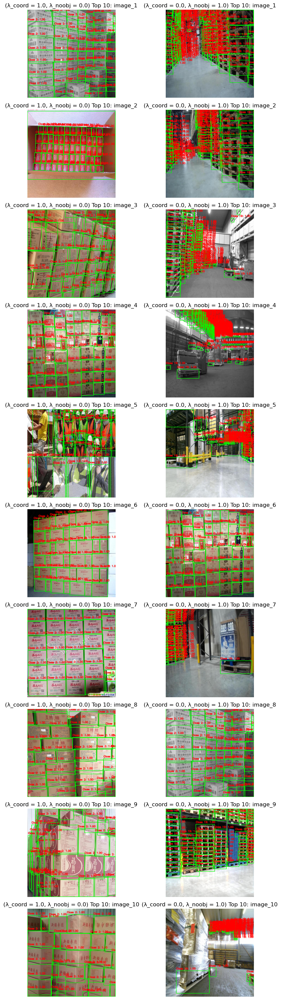

In [28]:
print("Task A - Display annotated images for top 10 hard negatives")
display_annotated_images(
    {'(λ_coord = 1.0, λ_noobj = 0.0) Top 10': top_10_hard_negatives_a1, 
     '(λ_coord = 0.0, λ_noobj = 1.0) Top 10': top_10_hard_negatives_a2}
)

Task A - Display annotated images for bottom 10 hard negatives


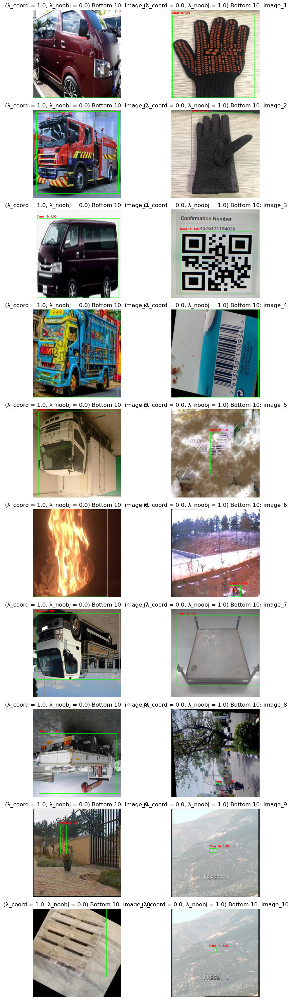

In [29]:
print("Task A - Display annotated images for bottom 10 hard negatives")
display_annotated_images(
    {'(λ_coord = 1.0, λ_noobj = 0.0) Bottom 10': bottom_10_hard_negatives_a1, 
     '(λ_coord = 0.0, λ_noobj = 1.0) Bottom 10': bottom_10_hard_negatives_a2,
    }
)

#### Observations & Analysis  
**How do different loss parameter settings (**λ_coord**, **λ_noobj**) impact the selection of hard negatives?**  
- λ_coord: Controls how much the model prioritizes accurate bounding box regression (higher means it focuses more on getting box positions correct).
- λ_noobj: Controls how much the model penalizes false positives in grid cells that should not contain objects.

Here we go through each case to discuss the observation and impact
- Case 1: (λ_coord = 1.0, λ_noobj = 0.0)
    - Findings:
        - The total loss is lower than other settings (both baseline and Case 2). Particularly, the loss for bottom ones are zero.
        - Since λ_coord = 1.0, the model focuses on refining bounding boxes for the detected objects. 
        - Since λ_noobj = 0, the model ignores false positives. 
    - Impact:
        - This setting over-prioritizes bounding box accuracy while ignoring false positives, which can increase detection errors.

- Case 2: (λ_coord = 0.0, λ_noobj = 1.0)
    - Findings:
        - The total loss is higher than other settings (both baseline and Case 1).
        - Since λ_coord = 0, the model completely ignores bounding box regression, meaning it does not refine object locations properly.
        - Since λ_noobj = 1.0, the model aggressively penalizes false positives in background cells (hard negatives).
    - Impact:
        - This setting over-prioritizes suppressing false positives but makes the model bad at learning object locations. 
        - The high loss suggests that the model struggles with hard negatives, but at the cost of poor bounding box learning.

- Baseline: (λ_coord = 0.5, λ_noobj = 0.5)
    - Findings:
        - The total loss is lower than Case 2 but higher than case 1.
        - With both λ_noobj and λ_coord as 0.5, the model penalizes false positives (hard negatives) while still refining bounding boxes.   

- Conclusion:
    - Given that Case 1 loss < Baseline loss < Case 2 loss, it indicates there are more localization error than false positives for the top hard negatives. That's why focusing on refining bounding boxes can provide better performance in general. 


**What types of samples are prioritized under each criterion?**  
- Case 1: (λ_coord = 1.0, λ_noobj = 0.0)
    - Prioritized detections are those with mistakenly placed bounding boxes
    - Particularly, the prioritized objects (top hard negatives) are cardboard boxes in the warehouse, and people faces.

- Case 2: (λ_coord = 0.0, λ_noobj = 1.0)
    - Prioritized detections are those with false positives
    - Particularly, the prioritized objects (top hard negatives) are cardboard boxes and wood pallets.


**Under what conditions would each parameter set be **most useful** for improving the model’s performance?** 
- If false positives are too high, then we can increase λ_noobj so that false positives will be penalized better. 
- If object to be detected is small, or we need to improve the localization, then we can increase λ_coord to refine bounding boxes.   

#

---

### **Task B:**

**1. Displaying Hard Negatives Varying Detector and NMS Parameters**  

- Display the **top 10** and **bottom 10** hard negatives with:  
  - *score_threshold = **0.5**
  - *iou_threshold = **0.1**

- Display the **top 10** and **bottom 10** hard negatives with:  
  - *score_threshold* = **0.5**
  - *iou_threshold* = **0.9** 

**2. Observations & Analysis**  

- How do different detector and non-maximum supression parameter settings (**score_threshold**, **iou_threshold**) impact the selection of hard negatives?  
- What types of samples are prioritized under each criterion?  
- Under what conditions would each parameter be **most useful** for improving the model’s performance?  

In [37]:
# Since NMS is not applied in hard negative selection, the results would be same as baseline performance.

print("Top 10 hard negatives using default parameters:")
display(top_10_hard_negatives_baseline)

print("Bottom 10 hard negatives using default parameters:")
display(bottom_10_hard_negatives_baseline)

Top 10 hard negatives using default parameters:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
1339,../storage/logistics/1579164086-6736007_jpg.rf...,../storage/logistics/1579164086-6736007_jpg.rf...,"([[0.84296875, 0.09140625, 0.3015625, 0.170312...",0.287468,12027.413236,155.205386,12182.906090
1336,../storage/logistics/1579163982-3432484_jpg.rf...,../storage/logistics/1579163982-3432484_jpg.rf...,"([[0.7484375, 0.371875, 0.209375, 0.140625], [...",0.381739,4547.357523,143.635904,4691.375166
1238,../storage/logistics/1574676188-741767_jpg.rf....,../storage/logistics/1574676188-741767_jpg.rf....,"([[0.80859375, 0.7734375, 0.0921875, 0.046875]...",0.136964,3517.929426,103.575710,3621.642099
1229,../storage/logistics/1574675826-0214434_jpg.rf...,../storage/logistics/1574675826-0214434_jpg.rf...,"([[0.51171875, 0.6234375, 0.0640625, 0.028125]...",0.027298,3370.668201,93.120342,3463.815840
7058,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,"([[0.9390625, 0.4984375, 0.121875, 0.14375], [...",0.438185,2173.951904,210.317137,2384.707226
2788,../storage/logistics/961899-5841_jpg.rf.99d927...,../storage/logistics/961899-5841_jpg.rf.99d927...,"([[0.96171875, 0.57890625, 0.0734375, 0.048437...",0.055023,2205.751662,53.167561,2258.974246
7050,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,"([[0.23671875, 0.00859375, 0.0609375, 0.017187...",0.681417,1944.232257,228.682299,2173.595974
1335,../storage/logistics/1579163928-9913452_jpg.rf...,../storage/logistics/1579163928-9913452_jpg.rf...,"([[0.79765625, 0.659375, 0.3578125, 0.146875],...",0.063887,2010.757037,63.934027,2074.754950
1327,../storage/logistics/1579163630-345785_jpg.rf....,../storage/logistics/1579163630-345785_jpg.rf....,"([[0.27734375, 0.6984375, 0.2046875, 0.13125],...",0.206793,1927.080565,136.385192,2063.672550
2492,../storage/logistics/510380776-956_jpg.rf.c85d...,../storage/logistics/510380776-956_jpg.rf.c85d...,"([[0.30703125, 0.83359375, 0.3765625, 0.254687...",0.195640,1916.451134,21.528248,1938.175023


Bottom 10 hard negatives using default parameters:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
3227,../storage/logistics/FWrexZvPmEf6gE3iEB2jacolg...,../storage/logistics/FWrexZvPmEf6gE3iEB2jacolg...,"([[0.47734375, 0.53203125, 0.9328125, 0.935937...",0.0,0.043012,0.0,0.043012
5236,../storage/logistics/fd5YCV2MuZEEKcZQS_mJlcntm...,../storage/logistics/fd5YCV2MuZEEKcZQS_mJlcntm...,"([[0.5765625, 0.49765625, 0.696875, 0.9203125]...",0.0,0.039434,0.0,0.039434
6900,../storage/logistics/monitorimage002_jpg.rf.3d...,../storage/logistics/monitorimage002_jpg.rf.3d...,"([[0.5125, 0.59609375, 0.828125, 0.7015625]], ...",0.0,0.023087,0.0,0.023087
3049,../storage/logistics/EAN13_09_0046_jpg.rf.ef5b...,../storage/logistics/EAN13_09_0046_jpg.rf.ef5b...,"([[0.53046875, 0.49921875, 0.9140625, 0.995312...",0.0,0.020399,0.0,0.020399
2210,../storage/logistics/4002039216304-01_N95-2592...,../storage/logistics/4002039216304-01_N95-2592...,"([[0.52890625, 0.49609375, 0.1765625, 0.473437...",0.0,0.020346,0.0,0.020346
5985,../storage/logistics/fire6_mp4-1184_jpg.rf.49a...,../storage/logistics/fire6_mp4-1184_jpg.rf.49a...,"([[0.7234375, 0.93125, 0.121875, 0.125]], [3])",0.0,0.015014,0.0,0.015014
3821,../storage/logistics/IMG_20230526_104135_074_j...,../storage/logistics/IMG_20230526_104135_074_j...,"([[0.53046875, 0.46953125, 0.9390625, 0.785937...",0.0,0.013299,0.0,0.013299
8750,../storage/logistics/traffic-light-654-_jpg.rf...,../storage/logistics/traffic-light-654-_jpg.rf...,"([[0.52265625, 0.8609375, 0.0578125, 0.025]], ...",0.0,0.007130,0.0,0.007130
5868,../storage/logistics/fire23_mp4-762_jpg.rf.507...,../storage/logistics/fire23_mp4-762_jpg.rf.507...,"([[0.4734375, 0.475, 0.0875, 0.046875]], [14])",0.0,0.002994,0.0,0.002994
5869,../storage/logistics/fire23_mp4-764_jpg.rf.8ec...,../storage/logistics/fire23_mp4-764_jpg.rf.8ec...,"([[0.4703125, 0.47109375, 0.0875, 0.0484375]],...",0.0,0.002501,0.0,0.002501


#### Observations & Analysis
**How do different detector and non-maximum supression parameter settings (**score_threshold**, **iou_threshold**) impact the selection of hard negatives?**  
- Neither NMS filter nor Detector.post_process is applied for Loss calculation, and thus, neither of those is applied for hard negative mining (which is based on the loss calculation).
- So both NMS paramters (score_threshold, iou_threshold) and Detector.score_threshold should not affect the selection of hard negatives.


**What types of samples are prioritized under each criterion?**
- Since neither of the parameters would affect hard negative selection, it will not priorize samples with certain criteria.

**Under what conditions would each parameter be most useful for improving the model’s performance?**
- Since neither of the parameters would affect loss calcluation, changing the condition will not be helpful to improve model performance, if it's evaluated by Loss.

#

---

### **Task C:**

**1. Displaying hard negatives while varying HardNegativeMiner parameters**  

- Display the **top 10** and **bottom 10** hard negatives using the default parameters:  
  - *criteria* = `total_loss`

- Display the **top 10** and **bottom 10** hard negatives with:  
  - *criteria* = `loc_loss`

- Display the **top 10** and **bottom 10** hard negatives with:  
  - *criteria* = `conf_loss_obj`

- Display the **top 10** and **bottom 10** hard negatives with:  
  - *criteria* = `class_loss`

**2. Observations & Analysis**  

- How do different loss parameter settings (**criteria**) impact the selection of hard negatives?  
- What types of samples are prioritized under each criterion?  
- Under what conditions would each parameter be **most useful** for improving the model’s performance?  

In [31]:
# Task A part_1: Display the **top 10** and **bottom 10** hard negatives with:  
#   criteria=total_loss # baseline

print("Top 10 hard negatives using criteria=total_loss:")
display(top_10_hard_negatives_baseline)

print("Bottom 10 hard negatives using criteria=total_loss:")
display(bottom_10_hard_negatives_baseline)



Top 10 hard negatives using criteria=total_loss:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
1339,../storage/logistics/1579164086-6736007_jpg.rf...,../storage/logistics/1579164086-6736007_jpg.rf...,"([[0.84296875, 0.09140625, 0.3015625, 0.170312...",0.287468,12027.413236,155.205386,12182.906090
1336,../storage/logistics/1579163982-3432484_jpg.rf...,../storage/logistics/1579163982-3432484_jpg.rf...,"([[0.7484375, 0.371875, 0.209375, 0.140625], [...",0.381739,4547.357523,143.635904,4691.375166
1238,../storage/logistics/1574676188-741767_jpg.rf....,../storage/logistics/1574676188-741767_jpg.rf....,"([[0.80859375, 0.7734375, 0.0921875, 0.046875]...",0.136964,3517.929426,103.575710,3621.642099
1229,../storage/logistics/1574675826-0214434_jpg.rf...,../storage/logistics/1574675826-0214434_jpg.rf...,"([[0.51171875, 0.6234375, 0.0640625, 0.028125]...",0.027298,3370.668201,93.120342,3463.815840
7058,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,"([[0.9390625, 0.4984375, 0.121875, 0.14375], [...",0.438185,2173.951904,210.317137,2384.707226
2788,../storage/logistics/961899-5841_jpg.rf.99d927...,../storage/logistics/961899-5841_jpg.rf.99d927...,"([[0.96171875, 0.57890625, 0.0734375, 0.048437...",0.055023,2205.751662,53.167561,2258.974246
7050,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,"([[0.23671875, 0.00859375, 0.0609375, 0.017187...",0.681417,1944.232257,228.682299,2173.595974
1335,../storage/logistics/1579163928-9913452_jpg.rf...,../storage/logistics/1579163928-9913452_jpg.rf...,"([[0.79765625, 0.659375, 0.3578125, 0.146875],...",0.063887,2010.757037,63.934027,2074.754950
1327,../storage/logistics/1579163630-345785_jpg.rf....,../storage/logistics/1579163630-345785_jpg.rf....,"([[0.27734375, 0.6984375, 0.2046875, 0.13125],...",0.206793,1927.080565,136.385192,2063.672550
2492,../storage/logistics/510380776-956_jpg.rf.c85d...,../storage/logistics/510380776-956_jpg.rf.c85d...,"([[0.30703125, 0.83359375, 0.3765625, 0.254687...",0.195640,1916.451134,21.528248,1938.175023


Bottom 10 hard negatives using criteria=total_loss:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
3227,../storage/logistics/FWrexZvPmEf6gE3iEB2jacolg...,../storage/logistics/FWrexZvPmEf6gE3iEB2jacolg...,"([[0.47734375, 0.53203125, 0.9328125, 0.935937...",0.0,0.043012,0.0,0.043012
5236,../storage/logistics/fd5YCV2MuZEEKcZQS_mJlcntm...,../storage/logistics/fd5YCV2MuZEEKcZQS_mJlcntm...,"([[0.5765625, 0.49765625, 0.696875, 0.9203125]...",0.0,0.039434,0.0,0.039434
6900,../storage/logistics/monitorimage002_jpg.rf.3d...,../storage/logistics/monitorimage002_jpg.rf.3d...,"([[0.5125, 0.59609375, 0.828125, 0.7015625]], ...",0.0,0.023087,0.0,0.023087
3049,../storage/logistics/EAN13_09_0046_jpg.rf.ef5b...,../storage/logistics/EAN13_09_0046_jpg.rf.ef5b...,"([[0.53046875, 0.49921875, 0.9140625, 0.995312...",0.0,0.020399,0.0,0.020399
2210,../storage/logistics/4002039216304-01_N95-2592...,../storage/logistics/4002039216304-01_N95-2592...,"([[0.52890625, 0.49609375, 0.1765625, 0.473437...",0.0,0.020346,0.0,0.020346
5985,../storage/logistics/fire6_mp4-1184_jpg.rf.49a...,../storage/logistics/fire6_mp4-1184_jpg.rf.49a...,"([[0.7234375, 0.93125, 0.121875, 0.125]], [3])",0.0,0.015014,0.0,0.015014
3821,../storage/logistics/IMG_20230526_104135_074_j...,../storage/logistics/IMG_20230526_104135_074_j...,"([[0.53046875, 0.46953125, 0.9390625, 0.785937...",0.0,0.013299,0.0,0.013299
8750,../storage/logistics/traffic-light-654-_jpg.rf...,../storage/logistics/traffic-light-654-_jpg.rf...,"([[0.52265625, 0.8609375, 0.0578125, 0.025]], ...",0.0,0.007130,0.0,0.007130
5868,../storage/logistics/fire23_mp4-762_jpg.rf.507...,../storage/logistics/fire23_mp4-762_jpg.rf.507...,"([[0.4734375, 0.475, 0.0875, 0.046875]], [14])",0.0,0.002994,0.0,0.002994
5869,../storage/logistics/fire23_mp4-764_jpg.rf.8ec...,../storage/logistics/fire23_mp4-764_jpg.rf.8ec...,"([[0.4703125, 0.47109375, 0.0875, 0.0484375]],...",0.0,0.002501,0.0,0.002501


In [32]:
# Task A part_2: Display the **top 10** and **bottom 10** hard negatives with:  
#   criteria=loc_loss

# Initialize the HardNegativeMiner
print("[INFO] Initializing HardNegativeMiner...")
hard_negative_miner = HardNegativeMiner(detector, measure, dataset_directory)
print("[INFO] HardNegativeMiner initialized.")

# Retrieve the top 10 and bottom 10 hard negatives (based on total_loss)
top_10_hard_negatives_c2, bottom_10_hard_negatives_c2 = hard_negative_miner.sample_hard_negatives(num_hard_negatives=10, criteria="loc_loss")
print("[INFO] Retrieved the top 10 and bottom 10 hard negatives")

print("Top 10 hard negatives using criteria=loc_loss:")
display(top_10_hard_negatives_c2)

print("Bottom 10 hard negatives using criteria=loc_loss:")
display(bottom_10_hard_negatives_c2)

[INFO] Initializing HardNegativeMiner...
[INFO] HardNegativeMiner initialized.
[INFO] Retrieved the top 10 and bottom 10 hard negatives
Top 10 hard negatives using criteria=loc_loss:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
7539,../storage/logistics/ppe_0750_jpg.rf.5e430fc3f...,../storage/logistics/ppe_0750_jpg.rf.5e430fc3f...,"([[0.8515625, 0.33046875, 0.15, 0.2046875], [0...",5.140297,134.591008,132.761762,272.493066
6545,../storage/logistics/image_from_china-1718-_jp...,../storage/logistics/image_from_china-1718-_jp...,"([[0.7921875, 0.0421875, 0.415625, 0.084375], ...",3.471227,161.610736,104.068970,269.150934
7643,../storage/logistics/ppe_1070_jpg.rf.4b2ae0097...,../storage/logistics/ppe_1070_jpg.rf.4b2ae0097...,"([[0.55078125, 0.5203125, 0.2765625, 0.959375]...",3.440587,67.348249,58.443957,129.232794
2947,../storage/logistics/CarLongPlateGen1340_jpg.r...,../storage/logistics/CarLongPlateGen1340_jpg.r...,"([[0.58671875, 0.58359375, 0.1921875, 0.085937...",3.399866,47.659427,66.523884,117.583177
7073,../storage/logistics/net-15715-_jpg.rf.56e5157...,../storage/logistics/net-15715-_jpg.rf.56e5157...,"([[0.4546875, 0.18125, 0.790625, 0.24375], [0....",3.334596,64.473032,63.815201,131.622830
181,../storage/logistics/0000000863_jpg.rf.ef0aa2c...,../storage/logistics/0000000863_jpg.rf.ef0aa2c...,"([[0.740625, 0.38984375, 0.4375, 0.7421875], [...",3.284209,61.106935,92.669908,157.061052
2330,../storage/logistics/4219d38195a84bf992d1c5f45...,../storage/logistics/4219d38195a84bf992d1c5f45...,"([[0.478125, 0.49453125, 0.43125, 0.9171875], ...",3.275163,27.059552,30.179741,60.514457
1928,../storage/logistics/25_jpg.rf.5d11328c91a5d96...,../storage/logistics/25_jpg.rf.5d11328c91a5d96...,"([[0.19296875, 0.534375, 0.2390625, 0.928125],...",3.254845,33.095727,35.044545,71.395117
7473,../storage/logistics/ppe_0547_jpg.rf.bc9c71764...,../storage/logistics/ppe_0547_jpg.rf.bc9c71764...,"([[0.84140625, 0.41953125, 0.3140625, 0.645312...",3.116011,95.274771,125.370968,223.761750
179,../storage/logistics/000000066771_jpg.rf.8564f...,../storage/logistics/000000066771_jpg.rf.8564f...,"([[0.27265625, 0.409375, 0.5359375, 0.8125], [...",3.036460,24.504292,36.611103,64.151855


Bottom 10 hard negatives using criteria=loc_loss:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
4615,../storage/logistics/Van160_jpg.rf.8668aa3fec1...,../storage/logistics/Van160_jpg.rf.8668aa3fec1...,"([[0.50078125, 0.5265625, 0.9953125, 0.946875]...",0.0,5.324051,0.0,5.324051
4601,../storage/logistics/VO83XQZF8H1R_jpg.rf.5e351...,../storage/logistics/VO83XQZF8H1R_jpg.rf.5e351...,"([[0.4734375, 0.49921875, 0.909375, 0.9984375]...",0.0,0.600081,0.0,0.600081
2741,../storage/logistics/87_resized_jpg.rf.e6ecde4...,../storage/logistics/87_resized_jpg.rf.e6ecde4...,"([[0.4984375, 0.51484375, 0.996875, 0.9640625]...",0.0,6.523152,0.0,6.523152
402,../storage/logistics/002325_jpg.rf.bc16abd12c4...,../storage/logistics/002325_jpg.rf.bc16abd12c4...,"([[0.4890625, 0.4546875, 0.965625, 0.834375]],...",0.0,9.333769,0.0,9.333769
4586,../storage/logistics/U5QKA9F6F7ZQ_jpg.rf.8d8f1...,../storage/logistics/U5QKA9F6F7ZQ_jpg.rf.8d8f1...,"([[0.490625, 0.5015625, 0.98125, 0.99375]], [4])",0.0,0.586281,0.0,0.586281
4573,../storage/logistics/TF2ZYE7IQENS_jpg.rf.e957d...,../storage/logistics/TF2ZYE7IQENS_jpg.rf.e957d...,"([[0.478125, 0.54765625, 0.903125, 0.9015625]]...",0.0,0.671217,0.0,0.671217
4570,../storage/logistics/T2QFSHC9TB5B_jpg.rf.98bfd...,../storage/logistics/T2QFSHC9TB5B_jpg.rf.98bfd...,"([[0.50625, 0.5, 0.94375, 1.0]], [4])",0.0,0.343994,0.0,0.343994
6016,../storage/logistics/fire6_mp4-254_jpg.rf.7f03...,../storage/logistics/fire6_mp4-254_jpg.rf.7f03...,"([[0.725, 0.8796875, 0.128125, 0.084375]], [3])",0.0,0.059054,0.0,0.059054
2764,../storage/logistics/8fd38915-8565-4d42-a8e0-3...,../storage/logistics/8fd38915-8565-4d42-a8e0-3...,"([[0.471875, 0.584375, 0.940625, 0.11875]], [19])",0.0,7.730707,0.0,7.730707
1933,../storage/logistics/2624dd287c1b3a1b_jpg.rf.0...,../storage/logistics/2624dd287c1b3a1b_jpg.rf.0...,"([[0.46015625, 0.88359375, 0.0109375, 0.042187...",0.0,1.464033,0.0,1.464033


In [33]:
# Task A part_3: Display the **top 10** and **bottom 10** hard negatives with:  
#   criteria=conf_loss_obj

# Initialize the HardNegativeMiner
print("[INFO] Initializing HardNegativeMiner...")
hard_negative_miner = HardNegativeMiner(detector, measure, dataset_directory)
print("[INFO] HardNegativeMiner initialized.")

# Retrieve the top 10 and bottom 10 hard negatives (based on total_loss)
top_10_hard_negatives_c3, bottom_10_hard_negatives_c3 = hard_negative_miner.sample_hard_negatives(num_hard_negatives=10, criteria="conf_loss_obj")
print("[INFO] Retrieved the top 10 and bottom 10 hard negatives")

print("Top 10 hard negatives using criteria=conf_loss_obj:")
display(top_10_hard_negatives_c3)

print("Bottom 10 hard negatives using criteria=conf_loss_obj:")
display(bottom_10_hard_negatives_c3)

[INFO] Initializing HardNegativeMiner...
[INFO] HardNegativeMiner initialized.
[INFO] Retrieved the top 10 and bottom 10 hard negatives
Top 10 hard negatives using criteria=conf_loss_obj:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
1339,../storage/logistics/1579164086-6736007_jpg.rf...,../storage/logistics/1579164086-6736007_jpg.rf...,"([[0.84296875, 0.09140625, 0.3015625, 0.170312...",0.287468,12027.413236,155.205386,12182.906090
1336,../storage/logistics/1579163982-3432484_jpg.rf...,../storage/logistics/1579163982-3432484_jpg.rf...,"([[0.7484375, 0.371875, 0.209375, 0.140625], [...",0.381739,4547.357523,143.635904,4691.375166
1238,../storage/logistics/1574676188-741767_jpg.rf....,../storage/logistics/1574676188-741767_jpg.rf....,"([[0.80859375, 0.7734375, 0.0921875, 0.046875]...",0.136964,3517.929426,103.575710,3621.642099
1229,../storage/logistics/1574675826-0214434_jpg.rf...,../storage/logistics/1574675826-0214434_jpg.rf...,"([[0.51171875, 0.6234375, 0.0640625, 0.028125]...",0.027298,3370.668201,93.120342,3463.815840
2788,../storage/logistics/961899-5841_jpg.rf.99d927...,../storage/logistics/961899-5841_jpg.rf.99d927...,"([[0.96171875, 0.57890625, 0.0734375, 0.048437...",0.055023,2205.751662,53.167561,2258.974246
7058,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,"([[0.9390625, 0.4984375, 0.121875, 0.14375], [...",0.438185,2173.951904,210.317137,2384.707226
1335,../storage/logistics/1579163928-9913452_jpg.rf...,../storage/logistics/1579163928-9913452_jpg.rf...,"([[0.79765625, 0.659375, 0.3578125, 0.146875],...",0.063887,2010.757037,63.934027,2074.754950
7050,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,"([[0.23671875, 0.00859375, 0.0609375, 0.017187...",0.681417,1944.232257,228.682299,2173.595974
1327,../storage/logistics/1579163630-345785_jpg.rf....,../storage/logistics/1579163630-345785_jpg.rf....,"([[0.27734375, 0.6984375, 0.2046875, 0.13125],...",0.206793,1927.080565,136.385192,2063.672550
2492,../storage/logistics/510380776-956_jpg.rf.c85d...,../storage/logistics/510380776-956_jpg.rf.c85d...,"([[0.30703125, 0.83359375, 0.3765625, 0.254687...",0.195640,1916.451134,21.528248,1938.175023


Bottom 10 hard negatives using criteria=conf_loss_obj:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
3227,../storage/logistics/FWrexZvPmEf6gE3iEB2jacolg...,../storage/logistics/FWrexZvPmEf6gE3iEB2jacolg...,"([[0.47734375, 0.53203125, 0.9328125, 0.935937...",0.0,0.043012,0.0,0.043012
5236,../storage/logistics/fd5YCV2MuZEEKcZQS_mJlcntm...,../storage/logistics/fd5YCV2MuZEEKcZQS_mJlcntm...,"([[0.5765625, 0.49765625, 0.696875, 0.9203125]...",0.0,0.039434,0.0,0.039434
6900,../storage/logistics/monitorimage002_jpg.rf.3d...,../storage/logistics/monitorimage002_jpg.rf.3d...,"([[0.5125, 0.59609375, 0.828125, 0.7015625]], ...",0.0,0.023087,0.0,0.023087
3049,../storage/logistics/EAN13_09_0046_jpg.rf.ef5b...,../storage/logistics/EAN13_09_0046_jpg.rf.ef5b...,"([[0.53046875, 0.49921875, 0.9140625, 0.995312...",0.0,0.020399,0.0,0.020399
2210,../storage/logistics/4002039216304-01_N95-2592...,../storage/logistics/4002039216304-01_N95-2592...,"([[0.52890625, 0.49609375, 0.1765625, 0.473437...",0.0,0.020346,0.0,0.020346
5985,../storage/logistics/fire6_mp4-1184_jpg.rf.49a...,../storage/logistics/fire6_mp4-1184_jpg.rf.49a...,"([[0.7234375, 0.93125, 0.121875, 0.125]], [3])",0.0,0.015014,0.0,0.015014
3821,../storage/logistics/IMG_20230526_104135_074_j...,../storage/logistics/IMG_20230526_104135_074_j...,"([[0.53046875, 0.46953125, 0.9390625, 0.785937...",0.0,0.013299,0.0,0.013299
8750,../storage/logistics/traffic-light-654-_jpg.rf...,../storage/logistics/traffic-light-654-_jpg.rf...,"([[0.52265625, 0.8609375, 0.0578125, 0.025]], ...",0.0,0.007130,0.0,0.007130
5868,../storage/logistics/fire23_mp4-762_jpg.rf.507...,../storage/logistics/fire23_mp4-762_jpg.rf.507...,"([[0.4734375, 0.475, 0.0875, 0.046875]], [14])",0.0,0.002994,0.0,0.002994
5869,../storage/logistics/fire23_mp4-764_jpg.rf.8ec...,../storage/logistics/fire23_mp4-764_jpg.rf.8ec...,"([[0.4703125, 0.47109375, 0.0875, 0.0484375]],...",0.0,0.002501,0.0,0.002501


In [34]:
# Task A part_4: Display the **top 10** and **bottom 10** hard negatives with:  
#   criteria=class_loss

# Initialize the HardNegativeMiner
print("[INFO] Initializing HardNegativeMiner...")
hard_negative_miner = HardNegativeMiner(detector, measure, dataset_directory)
print("[INFO] HardNegativeMiner initialized.")

# Retrieve the top 10 and bottom 10 hard negatives (based on total_loss)
top_10_hard_negatives_c4, bottom_10_hard_negatives_c4 = hard_negative_miner.sample_hard_negatives(num_hard_negatives=10, criteria="class_loss")
print("[INFO] Retrieved the top 10 and bottom 10 hard negatives")

print("Top 10 hard negatives using criteria=class_loss:")
display(top_10_hard_negatives_c4)

print("Bottom 10 hard negatives using criteria=class_loss:")
display(bottom_10_hard_negatives_c4)

[INFO] Initializing HardNegativeMiner...
[INFO] HardNegativeMiner initialized.
[INFO] Retrieved the top 10 and bottom 10 hard negatives
Top 10 hard negatives using criteria=class_loss:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
7050,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,../storage/logistics/net-15197-_jpg.rf.4c1d15f...,"([[0.23671875, 0.00859375, 0.0609375, 0.017187...",0.681417,1944.232257,228.682299,2173.595974
7042,../storage/logistics/net-15005-_jpg.rf.eed94a5...,../storage/logistics/net-15005-_jpg.rf.eed94a5...,"([[0.4984375, 0.40546875, 0.996875, 0.7734375]...",0.138983,744.804307,218.354007,963.297297
7112,../storage/logistics/net-4143-_jpg.rf.0f9c095a...,../storage/logistics/net-4143-_jpg.rf.0f9c095a...,"([[0.08046875, 0.303125, 0.1578125, 0.325], [0...",0.949354,963.548761,217.971555,1182.469670
7477,../storage/logistics/ppe_0568_jpg.rf.170869d80...,../storage/logistics/ppe_0568_jpg.rf.170869d80...,"([[0.15, 0.26953125, 0.18125, 0.5390625], [0.4...",1.567258,888.383106,211.070669,1101.021033
7058,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,../storage/logistics/net-1540-_jpg.rf.a3bc65ac...,"([[0.9390625, 0.4984375, 0.121875, 0.14375], [...",0.438185,2173.951904,210.317137,2384.707226
7150,../storage/logistics/net-9023-_jpg.rf.0fea7d32...,../storage/logistics/net-9023-_jpg.rf.0fea7d32...,"([[0.09765625, 0.19453125, 0.0546875, 0.132812...",0.420795,1440.628628,192.861292,1633.910714
7021,../storage/logistics/net-14665-_jpg.rf.77b47d6...,../storage/logistics/net-14665-_jpg.rf.77b47d6...,"([[0.10078125, 0.071875, 0.1984375, 0.1375], [...",0.917566,803.054806,182.843823,986.816194
7085,../storage/logistics/net-16099-_jpg.rf.45d9ff7...,../storage/logistics/net-16099-_jpg.rf.45d9ff7...,"([[0.1109375, 0.021875, 0.221875, 0.040625], [...",0.828272,1046.269093,176.333874,1223.431239
7113,../storage/logistics/net-4184-_jpg.rf.1adce7f5...,../storage/logistics/net-4184-_jpg.rf.1adce7f5...,"([[0.4109375, 0.3515625, 0.33125, 0.334375], [...",0.828886,496.654297,174.126969,671.610152
7367,../storage/logistics/ppe_0076_jpg.rf.73d1e482d...,../storage/logistics/ppe_0076_jpg.rf.73d1e482d...,"([[0.19375, 0.27578125, 0.24375, 0.3484375], [...",2.734382,142.374444,173.993159,319.101985


Bottom 10 hard negatives using criteria=class_loss:


,annotation_file,image_file,annotation,loc_loss,conf_loss_obj,class_loss,total_loss
2988,../storage/logistics/Container-514_jpg.rf.6ded...,../storage/logistics/Container-514_jpg.rf.6ded...,"([[0.5015625, 0.50859375, 0.996875, 0.9796875]...",0.0,2.310167,0.0,2.310167
3911,../storage/logistics/Image_013333_jpg.rf.35808...,../storage/logistics/Image_013333_jpg.rf.35808...,"([[0.51484375, 0.4640625, 0.9453125, 0.928125]...",0.0,2.538440,0.0,2.538440
2987,../storage/logistics/Container-496_jpg.rf.be51...,../storage/logistics/Container-496_jpg.rf.be51...,"([[0.46015625, 0.50546875, 0.9171875, 0.857812...",0.0,3.209551,0.0,3.209551
2986,../storage/logistics/Container-404_jpg.rf.d5c0...,../storage/logistics/Container-404_jpg.rf.d5c0...,"([[0.4171875, 0.52578125, 0.83125, 0.9484375]]...",0.0,3.008740,0.0,3.008740
2397,../storage/logistics/46KPQ0U6SV5O_jpg.rf.cbed5...,../storage/logistics/46KPQ0U6SV5O_jpg.rf.cbed5...,"([[0.4953125, 0.47578125, 0.990625, 0.9453125]...",0.0,2.072126,0.0,2.072126
3901,../storage/logistics/Image_013303_jpg.rf.04ba7...,../storage/logistics/Image_013303_jpg.rf.04ba7...,"([[0.48671875, 0.46171875, 0.9234375, 0.904687...",0.0,2.716861,0.0,2.716861
3902,../storage/logistics/Image_013303_jpg.rf.6e6d7...,../storage/logistics/Image_013303_jpg.rf.6e6d7...,"([[0.5140625, 0.4609375, 0.921875, 0.903125]],...",0.0,2.651662,0.0,2.651662
3905,../storage/logistics/Image_013313_jpg.rf.b5dfa...,../storage/logistics/Image_013313_jpg.rf.b5dfa...,"([[0.5203125, 0.46171875, 0.959375, 0.9234375]...",0.0,0.667990,0.0,0.667990
3910,../storage/logistics/Image_013332_jpg.rf.ec1e8...,../storage/logistics/Image_013332_jpg.rf.ec1e8...,"([[0.5046875, 0.540625, 0.990625, 0.8875]], [17])",0.0,4.081632,0.0,4.081632
7885,../storage/logistics/pt-label_3740_jpg.rf.9f5b...,../storage/logistics/pt-label_3740_jpg.rf.9f5b...,"([[0.49375, 0.5078125, 0.978125, 0.9625]], [1])",0.0,3.761094,0.0,3.761094


Task C - Display annotated images for Top 10 hard negatives


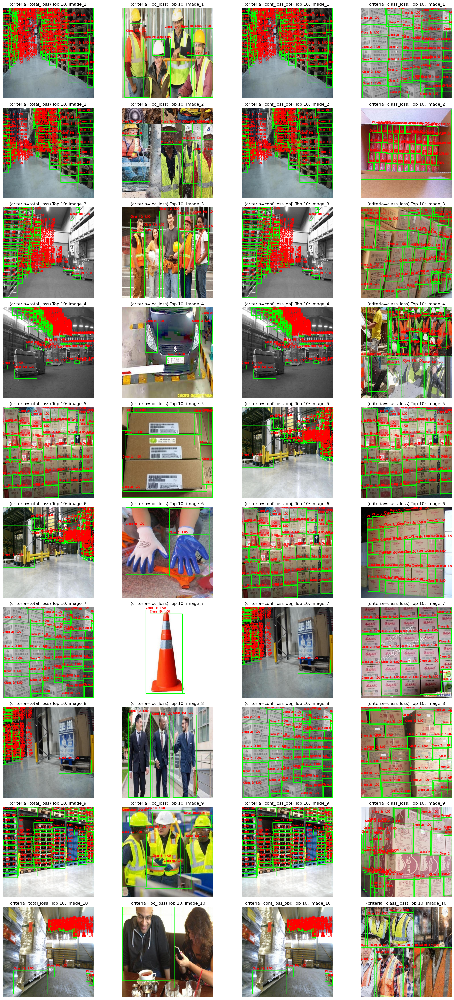

In [35]:
print("Task C - Display annotated images for Top 10 hard negatives")
display_annotated_images(
    {'(criteria=total_loss) Top 10': top_10_hard_negatives_baseline, 
     '(criteria=loc_loss) Top 10': top_10_hard_negatives_c2, 
     '(criteria=conf_loss_obj) Top 10': top_10_hard_negatives_c3, 
     '(criteria=class_loss) Top 10': top_10_hard_negatives_c4, 
    },
    figsize=(20, 40)
)

Task C - Display annotated images for Bottom 10 hard negatives


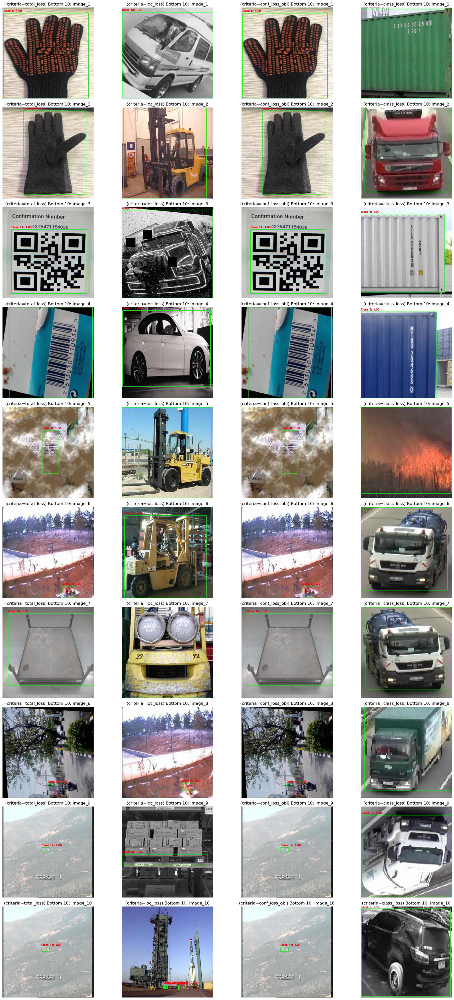

In [36]:
print("Task C - Display annotated images for Bottom 10 hard negatives")
display_annotated_images(
    {'(criteria=total_loss) Bottom 10': bottom_10_hard_negatives_baseline, 
     '(criteria=loc_loss) Bottom 10':  bottom_10_hard_negatives_c2, 
     '(criteria=conf_loss_obj) Bottom 10':  bottom_10_hard_negatives_c3, 
     '(criteria=class_loss) Bottom 10':  bottom_10_hard_negatives_c4, 
    },
    figsize=(20, 40)
)

#### Observations and Analysis 
1. Total Loss balances localization, confidence, and classification losses. 
    The total loss is a weighted aggregation of sub-losses of localization, confidence/objectness and classification. If well-balanced, it ensures hard negatives are penalized properly.

2. The confidence loss is dominant
    As stated above in the "Baseline Analysis", the sub-loss terms have different magnitudes due to different calculation methods. With the current setting, the confidence loss takes the dominant role. Thus the top 10 and bottom 10 hard nagatives between Criteria 1 and Criteria 3 are similar to each other, as illustrated above.



**How do different loss parameter settings (**criteria**) impact the selection of hard negatives?**

In general, the choice of which loss component to focus on during training impacts how well the model learns to distinguish objects from background.

| **Loss Component**      | **Effect on Hard Negatives** |
|-------------------------|----------------------------|
| **Total Loss (`total_loss`)** | Affects all aspects, balancing localization, classification, and confidence learning. |
| **Localization Loss (`loc_loss`)** | Encourages the model to improve bounding box accuracy|
| **Confidence Loss - Object (`conf_loss_obj`)** | Ensures detected objects are assigned high confidence; Also penalizes false positives. |
| **Classification Loss (`class_loss`)** | Ensures correct classification with identified object |

**What types of samples are prioritized under each criterion?**

| **Loss Component**      | **Prioritized samples** |
|-------------------------|----------------------------|
| **Total Loss (`total_loss`)** | General prioritization. The prioritization is based on the weight factor of sub-losses |
| **Localization Loss (`loc_loss`)** | Prioritize samples with mistakenly placed bounding boxes. |
| **Confidence Loss - Object (`conf_loss_obj`)** | Prioritize samples with large confidence score gaps between prediction and ground truth, as well as false positives (where pred_conf_score > 0 and ground_truth_score = 0). |
| **Classification Loss (`class_loss`)** | Prioritize samples with mis-labeled classes |

**Under what conditions would each parameter be **most useful** for improving the model’s performance?**

| **Loss Component**      | **Most useful condition** |
|-------------------------|----------------------------|
| **Total Loss (`total_loss`)** | General tuning, but needs careful weighting of sub-losses. |
| **Localization Loss (`loc_loss`)** | Cases where better localization is expected, for example, images with small objects to be detected|
| **Confidence Loss - Object (`conf_loss_obj`)** | Cases where smaller confidence score gap is needed. For example, image with background noise that may lead to many false positives |
| **Classification Loss (`class_loss`)** |Cases where more accurate classification is needed. For example, images with similar objects in different classes.|

---